In [1]:
from pydub import AudioSegment
from pydub.silence import split_on_silence
import matplotlib.pyplot as plt
import IPython.display as ipd

FILE_PATH = '../../skyhacks_hackathon_dataset/audio_description/20200421 zamek_pilcza_360_FINALNA_audiodeskrypcja.mp4'

In [2]:
AUDIO_FILE = 'audio.wav'

In [3]:
sound = AudioSegment.from_file(AUDIO_FILE, format="wav")

In [7]:
ipd.Audio(sound.get_array_of_samples(), rate=44100)

## Check dB value filtering

In [16]:
chunks = split_on_silence(
        sound,
        # split on silences longer than 1000ms (1 sec)
        min_silence_len=500,
        # anything under -25 dBFS is considered silence
        silence_thresh=-25, 
        # keep 200 ms of leading/trailing silence
        keep_silence=200
    )

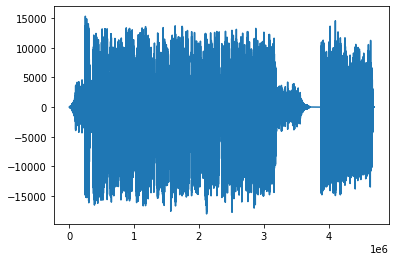

In [17]:
plt.plot(sound.get_array_of_samples())

In [20]:
merged = AudioSegment.empty()
for chunk in chunks:
    merged += chunk
ipd.Audio(merged.get_array_of_samples(), rate=44100)

In [21]:
for chunk in chunks:
    print(chunk.duration_seconds)

1.8270068027210884
4.4609977324263035
0.6749886621315193
3.4050113378684808
4.967981859410431
6.716009070294785
1.4619954648526077
2.7790022675736963
6.888004535147393
4.580997732426304
2.715011337868481
2.46
3.1559863945578233
4.919002267573696
2.2209977324263037
5.203990929705215
2.674013605442177
3.8660090702947847
2.2270068027210885
5.016984126984127
3.2960090702947844
1.7249886621315194
0.9949886621315193


In [41]:
# Recombine segments
segments = []

segment = AudioSegment.empty()

for chunk in chunks:
    if segment.duration_seconds + chunk.duration_seconds < 60:
        segment += chunk
    else:
        segments.append(segment)
        segment = chunk
segments.append(segment)

In [42]:
for segment in segments:
    print(segment.duration_seconds)

58.43698412698413
19.8


In [43]:
ipd.Audio(segments[1].get_array_of_samples(), rate=44100)

In [49]:
segments[0].export('tmp/seg0.wav', format='wav')

import speech_recognition as sr
sr.AudioFile('tmp/seg0.wav')

In [ ]:
r = sr.Recognizer()
with sr.AudioFile(f'tmp/seg{i}.wav') as source:
    audio = r.record(source) 


In [60]:
txt = open('text.txt').read()
print(txt)

 zamek pilcza w smoleniu film wykonany dronem ukazuje wzgórze zamkowe z ruinami zamku pilcza w smoleniu niewielkie wzgórze zamkowe porośnięte jest bukowym lasem z którego wyrasta Biała sylwetka cylindrycznej wieży bryły zamku i obronnych murów zrekonstruowany fragmenty białych kamiennych murów wybudowane z miejscowego wapienia dochodzą do 2 m brak dachówki stropu pozwala na rozpoznanie poszczególnych części zamków zamek składa się z dwu nieregularnych części Między którymi wznosi się cylindryczna 16 metrowa wieża obronna jedną część stanowi zamek dolny ze studnią i śladami pomieszczeń mieszkalnych drugą prawie prostokątne zamek Górny Otoczony dziedzińcem i murami obronnymi wieża została przystosowana do funkcji punktu widokowego widać z niej szachownicą pól i lasów oraz okoliczne zalesione wapienne Wzgórza zwłaszcza najbliższe zegarowe skały przy dobrej pogodzie ze szczytu wieży widoczna jest sylwetka zamku Ogrodzieniec kiego w pod oddalonego w prostej linii o 9 km wyprodukowano dla Śl

In [197]:
import requests
import json

def fetch_lexeme(word):
    resp = requests.post(
        'http://ws.clarin-pl.eu/lexrest/lex', 
        data=json.dumps({'task': 'all', 'tool': 'plwordnet', 'lexeme': word}),
        headers={'Content-Type': 'application/json'}
    )
    if resp.status_code != 200:
        # This means something went wrong.
        print(resp.content)
        return None
    word_lex = resp.json()
    return word_lex

In [217]:
resp = fetch_lexeme("zamek")
print(resp)

{'input': {'task': 'all', 'lexeme': 'zamek', 'tool': 'plwordnet'}, 'totaltime': 0.632, 'time': 0.6225636005401611, 'error': '', 'results': {'synsets': [{'str': '{zamek.5(3:wytw)}', 'related': {'hiponimia': [[58279, '{blokada.4(3:wytw)}']], 'synonimia_międzyjęzykowa/Syn_plWN-PWN': [[459354, '{lock.8(7:por), [+ 1 unit(s)]}']], 'fuzzynimia_synsetów': [[14075, '{informatyka.1(6:umy)}']]}, 'definition': '', 'id': 52769, 'units': [{'synset': 52769, 'lemma': 'zamek', 'emotion_markedness': None, 'str': 'zamek.5(3:wytw)', 'emotion_valuations': [], 'emotion_example_secondary': None, 'related': {}, 'pos': 'noun', 'external_links': ['https://pl.wikipedia.org/wiki/Blokada_(informatyka)'], 'emotion_example': None, 'domain': 'wytwory ludzkie (nazwy)', 'verb_aspect': None, 'variant': 5, 'definition': 'blokada w informatyce.', 'sense_examples': ['Używanie tych zamków zapobiega zamykaniu przez transakcję zamków shared, które w rzeczywistości będą musiały być zmienione na typ exclusive ze względu na koni

In [226]:
resp['results']['synsets'][5]

{'str': '{zamek.1(12:msc)}',
 'related': {'Międzyjęzykowy_typ/Typ_plWN-PWN': [[299809,
    '{Bastille.1(3:wytw)}'],
   [332795, '{Balmoral_Castle.1(12:msc)}']],
  'hiponimia': [[12499, '{rezydencja.1(12:msc)}'],
   [287, '{budowla.1(3:wytw)}'],
   [289, '{budynek.1(12:msc)}']],
  'synonimia_międzyjęzykowa/Syn_plWN-PWN': [[300889, '{castle.2(3:wytw)}']],
  'holonimia/część': [[8234, '{brama.2(3:wytw)}'],
   [11764, '{fortyfikacja.1(3:wytw), [+ 2 unit(s)]}'],
   [12530, '{strażnica.1(12:msc)}'],
   [12599, '{baszta.1(3:wytw)}']],
  'holonimia/miejsce': [[77174, '{pałanka.3(12:msc)}']],
  'hiperonimia': [[383714, '{bastylia.1(12:msc)}'],
   [77177, '{zamczysko.1(12:msc)}'],
   [35294, '{kasztel.2(3:wytw)}']],
  'egzemplarz': [[419666, '{Zamek_Ogrodzieniec.1(12:msc)}'],
   [411258, '{Windsor.1(12:msc)}'],
   [237409, '{Wawel.1(12:msc)}']],
  'meronimia/miejsce': [[399554, '{gród.3(12:msc)}']]},
 'definition': '',
 'id': 4189,
 'units': [{'synset': 4189,
   'lemma': 'zamek',
   'emotion_mar

In [229]:
related = []
related.append({
    'hiponimia': [e[1][e[1].find('{')+1:e[1].find('.')] for e in resp['results']['synsets'][5]['related']['hiponimia']],
    'hiperonimia': [e[1][e[1].find('{')+1:e[1].find('.')] for e in resp['results']['synsets'][5]['related']['hiperonimia']],
#     'collocation': [e[1][e[1].find('{')+1:e[1].find('.')] for e in resp['results']['synsets'][2]['units'][0]['related']['kolokacyjność']],
})
related

[{'hiponimia': ['rezydencja', 'budowla', 'budynek'],
  'hiperonimia': ['bastylia', 'zamczysko', 'kasztel']}]

[[[7242, '{mebel.1(3:wytw)}'], [7341, '{siedzenie.9(3:wytw), [+ 1 unit(s)]}']]]

In [182]:
# Translate ENG to PL - concept - discarded

WORD = 'castle'

def clean_word_resp(e):
    return e
    return e[1][e[1].find('{')+1:e[1].find('.')]

resp = requests.post(
    'http://ws.clarin-pl.eu/lexrest/lex', 
    data=json.dumps({'task': 'all', 'tool': 'plwordnet', 'lexeme': WORD}),
    headers={'Content-Type': 'application/json'}
)
if resp.status_code != 200:
    # This means something went wrong.
    print(resp.content)
polish_lex = resp.json()
for i, _ in enumerate(polish_lex['results']['synsets']):
    print(clean_word_resp(polish_lex['results']['synsets'][i]['related'].get('synonimia_międzyjęzykowa/Syn_PWN-plWN')))

[[20097, '{roszada.1(8:zdarz)}']]
None
None
[[4189, '{zamek.1(12:msc)}']]
[[7385, '{wieża.3(3:wytw)}']]


In [1]:
from nltk.corpus import wordnet as wn

for ss in wn.synsets('zamek'):
    for hyper in ss.hypernyms():
        print(ss, hyper)

Synset('zamek.n.01') Synset('budowla_obronna.n.01')
Synset('zamek.n.01') Synset('budynek.n.01')
Synset('zamek.n.01') Synset('rezydencja.n.01')
Synset('zamek.n.02') Synset('zamknięcie.n.12')
Synset('zamek.n.03') Synset('blokada.n.04')
Synset('zamek.n.03') Synset('mechanizm.n.02')
Synset('zamek.n.04') Synset('mechanizm.n.02')
Synset('zamek.n.04') Synset('zamek.n.03')
Synset('zamek.n.05') Synset('blokada.n.04')
Synset('ekler.n.02') Synset('zapięcie.n.02')
Synset('zamek.n.07') Synset('zagrywka.n.02')


In [2]:
WORD = 'zamek'
print(wn.synsets(WORD)[0].lemma_names())
print(wn.synsets(WORD)[0].hyponyms())
print(wn.synsets(WORD)[0].hypernyms())
print(wn.synsets(WORD)[0].part_holonyms())
print(wn.synsets(WORD)[0].part_meronyms())
print(wn.synsets(WORD)[0].entailments())

wn.synsets(WORD)[0].hyponyms()[0].lemma_names()

['zamek']
[Synset('bastylia.n.01'), Synset('kasztel.n.02'), Synset('zamczysko.n.01')]
[Synset('budowla_obronna.n.01'), Synset('budynek.n.01'), Synset('rezydencja.n.01')]
[]
[Synset('baszta.n.01'), Synset('brama.n.02'), Synset('strażnica.n.01'), Synset('umocnienie.n.04')]
[]


['bastylia']

In [3]:
wn.synsets(WORD)[0].lemmas()[0].derivationally_related_forms()
# wn.synsets(WORD)[0].lemmas()[0].pertainyms()

[Lemma('przedzamkowy.a.01.przedzamkowy')]

In [4]:
for lemma in wn.synsets(WORD)[0].lemmas():
    print(lemma)

Lemma('zamek.n.01.zamek')


In [5]:
print(wn.synsets('obronny')[0].path_similarity(wn.synsets('zamek')[0]))

None


In [6]:
hypo = lambda s: s.hyponyms()
hyper = lambda s: s.hypernyms()

list(wn.synsets(WORD)[0].closure(hyper, depth=2))

[Synset('budowla_obronna.n.01'),
 Synset('budynek.n.01'),
 Synset('rezydencja.n.01'),
 Synset('budowla.n.01'),
 Synset('dom.n.01'),
 Synset('siedziba.n.02')]

In [7]:
from nltk.corpus import wordnet as wn

In [8]:
def list_synsets(word):
    synsets = wn.synsets(WORD)
    for ss in synsets:
        print(f'{ss.name()} -- {ss.definition()}')
    
list_synsets('zamek')

zamek.n.01 -- warowna budowla mieszkalna, rezydencja pana, króla, księcia lub magnata
zamek.n.02 -- urządzenie do zamykania drzwi, szuflad, walizek
zamek.n.03 -- urządzenie do łączenia lub zabezpieczania w ustalonym położeniu elementów maszyny
zamek.n.04 -- mechanizm broni palnej służący do zamykania na czas wystrzału i otwierania po strzale tylnej części lufy
zamek.n.05 -- blokada w informatyce
ekler.n.02 -- rodzaj zapięcia przy ubraniu
zamek.n.07 -- zagranie taktyczne w hokeju; zamknięcie przeciwnika w jego tercji lodowiska/boiska


In [232]:
def find_related_words(word, syn_id=0):
    base_lemma = wn.synsets(word)[syn_id]
    lemmas = base_lemma.lemma_names()
    print(lemmas)
    
    hyponyms = [ss.lemma_names() for ss in base_lemma.hyponyms()]
    hypernyms = [ss.lemma_names() for ss in base_lemma.hypernyms()]
    part_holonyms = [ss.lemma_names() for ss in base_lemma.part_holonyms()]
    part_meronyms = [ss.lemma_names() for ss in base_lemma.part_meronyms()]
    entailments = [ss.lemma_names() for ss in base_lemma.entailments()]
    print(hyponyms)
    print(hypernyms)
    print(part_holonyms)
    print(part_meronyms)
    print(entailments)
    print([ss.name() for ss in base_lemma.lemmas()[0].pertainyms()])
    print([ss.name() for ss in base_lemma.lemmas()[0].derivationally_related_forms()])
    
find_related_words('roślina')

['roślina']
[['acena'], ['acydofit', 'roślina_kwasolubna', 'roślina_acydofilna'], ['akroptilon', 'gorczak'], ['ambrozja'], ['anemochor'], ['anoda'], ['antropofit'], ['apofit'], ['arnika'], ['badyl'], ['bartsja'], ['begonia', 'ukośnica'], ['bertram', 'pierściennik'], ['bodziszek', 'geranium'], ['bożykwiat'], ['chroszcz'], ['chłodek'], ['cieszynianka'], ['czarcikęsik'], ['czechrzyca'], ['czep'], ['drapacz'], ['dwurząd'], ['efemerofit'], ['efemeryda'], ['elisma'], ['eonium', 'aeonium'], ['erechtites'], ['erynus'], ['eszeweria'], ['fanerofit', 'roślina_jawnopączkowa'], ['fedimus'], ['gametofit'], ['garbownik'], ['glaukocystofit'], ['goryczel'], ['goździeniec'], ['gruszycznik', 'monezes'], ['grzebykowiec', 'grzebyk', 'plewikwiat'], ['grzybieńczyk'], ['gurdlina'], ['gwiazdosz'], ['haoma'], ['haploid'], ['heliofit', 'roślina_światłożądna', 'roślina_światłolubna'], ['heliotrop', 'tomiłek'], ['hemikryptofit', 'roślina_naziemnopączkowa'], ['higrofit', 'hygrofit'], ['horminum'], ['ifejon'], ['jar

In [10]:
from stempel import StempelStemmer
stemmer = StempelStemmer.polimorf()

Loading:  99%|█████████▉| 11307002/11368252 [00:06<00:00, 1182975.63bytes/s]

In [11]:
for word in ['zamek', 'zamki', 'zamiast', 'zamknięty', 'zamyka']:
    print(stemmer.stem(word))

zamek
zamek
zamiasto
zamknięty
zamykać


In [12]:
txt = open('text.txt').read()
print(txt)

 zamek pilcza w smoleniu film wykonany dronem ukazuje wzgórze zamkowe z ruinami zamku pilcza w smoleniu niewielkie wzgórze zamkowe porośnięte jest bukowym lasem z którego wyrasta Biała sylwetka cylindrycznej wieży bryły zamku i obronnych murów zrekonstruowany fragmenty białych kamiennych murów wybudowane z miejscowego wapienia dochodzą do 2 m brak dachówki stropu pozwala na rozpoznanie poszczególnych części zamków zamek składa się z dwu nieregularnych części Między którymi wznosi się cylindryczna 16 metrowa wieża obronna jedną część stanowi zamek dolny ze studnią i śladami pomieszczeń mieszkalnych drugą prawie prostokątne zamek Górny Otoczony dziedzińcem i murami obronnymi wieża została przystosowana do funkcji punktu widokowego widać z niej szachownicą pól i lasów oraz okoliczne zalesione wapienne Wzgórza zwłaszcza najbliższe zegarowe skały przy dobrej pogodzie ze szczytu wieży widoczna jest sylwetka zamku Ogrodzieniec kiego w pod oddalonego w prostej linii o 9 km wyprodukowano dla Śl

In [13]:
' '.join([stemmer.stem(word) for word in txt.split(' ') if word])

'zamek pilczy wyspa smolić film wykonać dron ukazywać wzgórze zamkowy ezyt ruina zamek pilczy wyspa smolić niewielki wzgórze zamkowy poróść być bukowy las ezyt kyy wyrastać Białativus sylwetka cylindryczny wieża bryła zamek i obronny mur zrekonstruować fragment biały kamienny mur wybudować ezyt miejscowy wapień dochodzić dojciec 2 morze brak dachówka strop pozwalać nativus rozpoznanie poszczególny część zamek zamek składać się ezyt aaa nieregularny część Między który wznosić się cylindryczny 16 metrowy wieża obronny jeden część stanowy zamek dolny z studnia i ślad pomieścić mieszkalny drugi prawo prostokątny zamek Górny Otoczyć dziedziniec i mur obronny wieża zostać przystosować dojciec funkcja punkt widokowy widać ezyt on szachownica pole i las oraz okoliczny zalesiony wapienny Wzgórze zwłaszczać najbliski zegarowy skała przy dobry pogoda z szczyt wieża widoczny być sylwetka zamek Ogrodzieniec ki wyspa pod oddalony wyspa prosty linia ojciec 9 kwadratometr wyprodukować dlativus Śląski 

In [14]:
stemmer.stem('w')

'wyspa'

In [15]:
import spacy
nlp = spacy.load('pl_core_news_sm')

Loading: 100%|██████████| 11368252/11368252 [00:10<00:00, 1092411.05bytes/s]


In [16]:
print(txt)

 zamek pilcza w smoleniu film wykonany dronem ukazuje wzgórze zamkowe z ruinami zamku pilcza w smoleniu niewielkie wzgórze zamkowe porośnięte jest bukowym lasem z którego wyrasta Biała sylwetka cylindrycznej wieży bryły zamku i obronnych murów zrekonstruowany fragmenty białych kamiennych murów wybudowane z miejscowego wapienia dochodzą do 2 m brak dachówki stropu pozwala na rozpoznanie poszczególnych części zamków zamek składa się z dwu nieregularnych części Między którymi wznosi się cylindryczna 16 metrowa wieża obronna jedną część stanowi zamek dolny ze studnią i śladami pomieszczeń mieszkalnych drugą prawie prostokątne zamek Górny Otoczony dziedzińcem i murami obronnymi wieża została przystosowana do funkcji punktu widokowego widać z niej szachownicą pól i lasów oraz okoliczne zalesione wapienne Wzgórza zwłaszcza najbliższe zegarowe skały przy dobrej pogodzie ze szczytu wieży widoczna jest sylwetka zamku Ogrodzieniec kiego w pod oddalonego w prostej linii o 9 km wyprodukowano dla Śl

In [17]:
' '.join([token.lemma_ for token in nlp(txt)])

'  zamek pilcza w smoleniu film wykonać dron ukazywać wzgórze zamkowy z ruina zamek pilcza w smoleniu wielki wzgórze zamkowy poróść być bukowy las z który wyrastać biały sylwetka cylindryczny wieża bryła zamek i obronny mur zrekonstruować fragment biały kamienny mur wybudować z miejscowy wapień dochodzić do 2 m brak dachówka strop pozwalać na rozpoznanie poszczególny część zamek zamek składać się z dwa regularny część między który wznosić się cylindryczny 16 metrowy wieża obronny jeden część stanowić zamek dolny z studnia i ślad pomieszczenie mieszkalny drugi prawie prostokątny zamek górny otoczyć dziedziniec i mur obronny wieża zostać przystosować do funkcja punkt widokowy widać z on szachownica pole i las oraz okoliczny zalesiony wapienny wzgórze zwłaszcza bliski zegarowy skała przy dobry pogoda z szczyt wieża widoczny być sylwetka zamek ogrodzieniec ki w pod oddalić w prosty linia o 9 km wyprodukować dla śląski organizacja turystyczny przez open group www open group com.pl więcej na

## Final solution?

In [253]:
CSV_FILE = '../../submission.csv'

def get_labels(file_path):
    with open(file_path) as file:
        headers = next(file).replace('\n', '')
        return [word.lower() for word in headers.split(',')[1:]]

model_labels_en = get_labels(CSV_FILE)
print(model_labels_en)

['amusement park', 'animals', 'bench', 'building', 'castle', 'cave', 'church', 'city', 'cross', 'cultural institution', 'food', 'footpath', 'forest', 'furniture', 'grass', 'graveyard', 'lake', 'landscape', 'mine', 'monument', 'motor vehicle', 'mountains', 'museum', 'open-air museum', 'park', 'person', 'plants', 'reservoir', 'river', 'road', 'rocks', 'snow', 'sport', 'sports facility', 'stairs', 'trees', 'watercraft', 'windows']


In [56]:
# for label in model_labels_en:
#     print(label)

In [141]:
model_labels = [
    'park rozrywki', 'zwierzę', 'ławka', 'budynek', 'zamek', 'jaskinia', 'kościół', 'miasto', 'krzyż', 'instytucja kultury',
    'jedzenie', 'chodnik', 'las', 'mebel', 'trawa', 'cmentarz', 'jezioro', 'krajobraz', 'kopalnia', 'pomnik', 'pojazd silnikowy',
    'góry', 'muzeum', 'skansen', 'park', 'osoba', 'roślina', 'zbiornik wodny', 'rzeka', 'droga', 'kamień', 'śnieg', 'sport',
    'obiekt sportowy', 'schody', 'drzewo', 'statek', 'okno'
]

In [142]:
for en, pl in zip(model_labels_en, model_labels):
    print(f'{en} = {pl}')

amusement park = park rozrywki
animals = zwierzę
bench = ławka
building = budynek
castle = zamek
cave = jaskinia
church = kościół
city = miasto
cross = krzyż
cultural institution = instytucja kultury
food = jedzenie
footpath = chodnik
forest = las
furniture = mebel
grass = trawa
graveyard = cmentarz
lake = jezioro
landscape = krajobraz
mine = kopalnia
monument = pomnik
motor vehicle = pojazd silnikowy
mountains = góry
museum = muzeum
open-air museum = skansen
park = park
person = osoba
plants = roślina
reservoir = zbiornik wodny
river = rzeka
road = droga
rocks = kamień
snow = śnieg
sport = sport
sports facility = obiekt sportowy
stairs = schody
trees = drzewo
watercraft = statek
windows = okno


In [143]:
import spacy
nlp = spacy.load('pl_core_news_sm')

In [144]:
labels_lemma = ' '.join([token.lemma_ for token in nlp(', '.join(model_labels))]).split(' , ')
print(labels_lemma)

['park rozrywka', 'zwierzę', 'ławka', 'budynek', 'zamek', 'jaskinia', 'kościół', 'miasto', 'krzyż', 'instytucja kultura', 'jedzenie', 'chodnik', 'lasa', 'mebel', 'trawa', 'cmentarz', 'jezioro', 'krajobraz', 'kopalnia', 'pomnik', 'pojazda silnikowy', 'góra', 'muzeum', 'skansen', 'park', 'osoba', 'roślina', 'zbiornik wodny', 'rzeka', 'droga', 'kamień', 'śnieg', 'sport', 'obiekt sportowy', 'schód', 'drzewo', 'statek', 'okno']


# Check synsets for each label

In [247]:
def list_synsets(word):
    synsets = wn.synsets(word)
    for ss in synsets:
        print(f'{ss.name()} -- {ss.definition()}')
    print()
 
for word in model_labels:
    list_synsets(word)


zwierzę.n.01 -- 
zwierzę.n.02 -- 
zwyrodnialec.n.01 -- 
zwierzę.n.04 -- 

ławka.n.01 -- 
ławka.n.02 -- 

budynek.n.01 -- 

zamek.n.01 -- warowna budowla mieszkalna, rezydencja pana, króla, księcia lub magnata
zamek.n.02 -- urządzenie do zamykania drzwi, szuflad, walizek
zamek.n.03 -- urządzenie do łączenia lub zabezpieczania w ustalonym położeniu elementów maszyny
zamek.n.04 -- mechanizm broni palnej służący do zamykania na czas wystrzału i otwierania po strzale tylnej części lufy
zamek.n.05 -- blokada w informatyce
ekler.n.02 -- rodzaj zapięcia przy ubraniu
zamek.n.07 -- zagranie taktyczne w hokeju; zamknięcie przeciwnika w jego tercji lodowiska/boiska

grota.n.01 -- 

kościół.n.01 -- 
dom_boży.n.01 -- 
kościół.n.03 -- 
kościół.n.04 -- 

miasto.n.01 -- brak danych
magistrat.n.02 -- 
miasto.n.03 -- 

krzyż.n.01 -- 
krzyż.n.02 -- 
krzyż.n.03 -- 
krzyż.n.04 -- 
golgota.n.01 -- 
krzyż.n.06 -- 
krzyż_wielkopolski.n.01 -- 
krzyż.n.08 -- 
krzyż.n.09 -- 
krzyż.n.10 -- 


konsumpcja.n.02 -- 


In [248]:
def flatten(list):
    return [e[0] for e in list]

def find_related_words(word, syn_id=0):
    base_lemma = wn.synsets(word)
    if not base_lemma:
        return []
    base_lemma = base_lemma[syn_id]
    lemmas = base_lemma.lemma_names()
    
#     hyponyms = [ss.lemma_names() for ss in base_lemma.hyponyms()]
    hypernyms = flatten([ss.lemma_names() for ss in base_lemma.hypernyms()])
    part_holonyms = flatten([ss.lemma_names() for ss in base_lemma.part_holonyms()])
    part_meronyms = flatten([ss.lemma_names() for ss in base_lemma.part_meronyms()])
    entailments = flatten([ss.lemma_names() for ss in base_lemma.entailments()])
    related = [ss.name() for ss in base_lemma.lemmas()[0].derivationally_related_forms()]
#     print(*hyponyms)  # often too random
#     print(hypernyms)
#     print(part_holonyms)
#     print(part_meronyms)
#     print(entailments)
    return [*lemmas, *hypernyms, *part_holonyms, *part_meronyms, *entailments, *related]

labels = {}
for word_pl, word_en in zip(model_labels, model_labels_en):
    related = [e.replace('_', ' ') for e in find_related_words(word_pl.replace(' ', '_'))]
    labels[word_en] = related
labels

{'amusement park': ['park rozrywki', 'wesołe miasteczko'],
 'animals': ['zwierzę',
  'indywiduum',
  'wielokomórkowiec',
  'farba',
  'grzbiet',
  'jęzor',
  'paszcza',
  'przyssawka',
  'wylinka',
  'zwierzokształtny'],
 'bench': ['ławka', 'mebel', 'siedzenie'],
 'building': ['budynek',
  'budowla',
  'alkierz',
  'balkon',
  'blok',
  'front',
  'fundament',
  'klatka schodowa',
  'kondygnacja',
  'podłoga',
  'przedproże',
  'skrzydło',
  'strop',
  'zadaszenie'],
 'castle': ['zamek',
  'budowla obronna',
  'budynek',
  'rezydencja',
  'baszta',
  'brama',
  'strażnica',
  'umocnienie',
  'przedzamkowy'],
 'cave': ['grota',
  'jaskinia',
  'pieczara',
  'wklęśnięcie',
  'komora',
  'korytarz',
  'strop'],
 'church': ['Kościół',
  'Kościół katolicki',
  'kościół',
  'diecezja',
  'kapituła',
  'prowincja',
  'wikariat apostolski',
  'antykościelny',
  'prokościelny',
  'ogólnokościelny'],
 'city': ['miasto',
  'gród',
  'miejscowość',
  'aglomeracja',
  'megapolis',
  'dzielnica',
  

# Few manual improvements

# Lemmize labels

In [249]:
lemmized_labels = {}
for label in labels:
    lemmized_labels[label] = [' '.join([t.lemma_ for t in nlp(l)]) for l in labels[label]]
lemmized_labels

{'amusement park': ['park rozrywka', 'wesoły miasteczko'],
 'animals': ['zwierzę',
  'indywiduum',
  'wielokomórkowiec',
  'farba',
  'grzbiet',
  'jęzor',
  'paszcza',
  'przyssawka',
  'wylinka',
  'zwierzokształtny'],
 'bench': ['ławka', 'mebel', 'siedzenie'],
 'building': ['budynek',
  'budowla',
  'alkierz',
  'balkon',
  'blok',
  'front',
  'fundament',
  'klatka schodowy',
  'kondygnacja',
  'podłoga',
  'przedproże',
  'skrzydło',
  'strop',
  'zadaszenie'],
 'castle': ['zamek',
  'budowla obronny',
  'budynek',
  'rezydencja',
  'baszta',
  'brama',
  'strażnica',
  'umocnienie',
  'przedzamkowy'],
 'cave': ['grota',
  'jaskinia',
  'pieczara',
  'wklęsnąć',
  'komora',
  'korytarz',
  'strop'],
 'church': ['kościół',
  'kościół katolicki',
  'kościół',
  'diecezja',
  'kapituła',
  'prowincja',
  'wikariat apostolski',
  'antykościelny',
  'prokościelny',
  'ogólnokościelny'],
 'city': ['miasto',
  'gród',
  'miejscowość',
  'aglomeracja',
  'megapolis',
  'dzielnica',
  'os

# Detect labels

In [250]:
lemmized_txt = ' '.join([token.lemma_ for token in nlp(txt)])
print(lemmized_txt)

detected = {}
for k, v in lemmized_labels.items():
    for w in v:
        if w in lemmized_txt:
            if k not in detected.keys():
                detected[k] = {}
            if w not in detected[k].keys():
                detected[k][w] = 0
            detected[k][w] = lemmized_txt.count(w)
    

print(f'\n\nLabels: {detected}')

  zamek pilcza w smoleniu film wykonać dron ukazywać wzgórze zamkowy z ruina zamek pilcza w smoleniu wielki wzgórze zamkowy poróść być bukowy las z który wyrastać biały sylwetka cylindryczny wieża bryła zamek i obronny mur zrekonstruować fragment biały kamienny mur wybudować z miejscowy wapień dochodzić do 2 m brak dachówka strop pozwalać na rozpoznanie poszczególny część zamek zamek składać się z dwa regularny część między który wznosić się cylindryczny 16 metrowy wieża obronny jeden część stanowić zamek dolny z studnia i ślad pomieszczenie mieszkalny drugi prawie prostokątny zamek górny otoczyć dziedziniec i mur obronny wieża zostać przystosować do funkcja punkt widokowy widać z on szachownica pole i las oraz okoliczny zalesiony wapienny wzgórze zwłaszcza bliski zegarowy skała przy dobry pogoda z szczyt wieża widoczny być sylwetka zamek ogrodzieniec ki w pod oddalić w prosty linia o 9 km wyprodukować dla śląski organizacja turystyczny przez open group www open group com.pl więcej na 

In [251]:
base_lemma = wn.synsets('roślina')[0]
print([ss.name() for ss in base_lemma.lemmas()[0].derivationally_related_forms()])

['roślinka', 'rośliniarka', 'roślinny']
